In [1]:
import pandas as pd
# import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, cross_val_score, train_test_split
from sklearn.metrics import make_scorer, mean_absolute_error, r2_score
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
import lightgbm as lgb
import shap
import lime
import os
# from joblib import dump
import joblib
import warnings
import statsmodels.api as sm
import numpy as np

warnings.filterwarnings('ignore')
# import dask.dataframe as dd


# Format setup

In [2]:
exps_dir = "../../exps"
if os.path.exists(exps_dir) == False: # tạo thư mục (nếu chưa có)
  os.makedirs(exps_dir, exist_ok=True)

save_dir = f"{exps_dir}/exp2"
os.makedirs(save_dir, exist_ok=True)

In [3]:
style_dir='../../styles'
plt.style.use(f'{style_dir}/style.mplstyle')
shap.initjs()

# Load Dataset

In [4]:
ndays=1
X=pd.read_csv(f'{save_dir}/X.csv', index_col=None)
y=pd.read_csv(f'{save_dir}/y.csv', index_col=None)
X_train=pd.read_csv(f'{save_dir}/X_train.csv', index_col=None)
X_valid=pd.read_csv(f'{save_dir}/X_valid.csv', index_col=None)
y_train=pd.read_csv(f'{save_dir}/y_train.csv', index_col=None)
y_valid=pd.read_csv(f'{save_dir}/y_valid.csv', index_col=None)
X_test=pd.read_csv(f'{save_dir}/X_test.csv', index_col=None)
y_test=pd.read_csv(f'{save_dir}/y_test.csv', index_col=None)

best_params = dict(np.load(f'{save_dir}/best_params_.npz',allow_pickle=True))


In [5]:
X.drop(columns=['Unnamed: 0'], inplace=True)
y.drop(columns=['Unnamed: 0'], inplace=True)
X_train.drop(columns=['Unnamed: 0'], inplace=True)
X_valid.drop(columns=['Unnamed: 0'], inplace=True)
y_train.drop(columns=['Unnamed: 0'], inplace=True)
y_valid.drop(columns=['Unnamed: 0'], inplace=True)
print(X_train.shape, y_train.shape, X_valid.shape, y_valid.shape)

(1079454, 141) (1079454, 1) (531672, 141) (531672, 1)


In [6]:
X_test.drop(columns=['Unnamed: 0'], inplace=True)
y_test.drop(columns=['Unnamed: 0'], inplace=True)

### Analyze the regression relation

#### Use OLS regression

In [10]:
def analyze_OLS(x,y):
    x = sm.add_constant(x)  
    model = sm.OLS(y, x,hasconst=True)
    results = model.fit()
    summary = results.summary()
    # print(summary)
    return summary
print(analyze_OLS(X,y))

                            OLS Regression Results                            
Dep. Variable:                 target   R-squared:                       0.881
Model:                            OLS   Adj. R-squared:                  0.881
Method:                 Least Squares   F-statistic:                 1.208e+05
Date:                Tue, 09 Jul 2024   Prob (F-statistic):               0.00
Time:                        21:10:54   Log-Likelihood:            -1.1674e+07
No. Observations:             1622156   AIC:                         2.335e+07
Df Residuals:                 1622056   BIC:                         2.335e+07
Df Model:                          99                                         
Covariance Type:            nonrobust                                         
                                              coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------

#### Use Linear machine learning model

In [11]:
def print_sorted_coefficients(model, model_name, feature_names):
    coef = model.coef_
    if len(coef.shape) > 1:
        coef = coef[0]
    sorted_indices = np.argsort(-np.abs(coef))  
    sorted_coef = coef[sorted_indices]
    sorted_feature_names = [feature_names[i] for i in sorted_indices]
    for i, (name, value) in enumerate(zip(sorted_feature_names, sorted_coef)):
        print(f"{model_name} Coefficient {i + 1}: {name}, Coefficient: {value}")

In [12]:
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
y_pred_linear = linear_model.predict(X_valid)

print_sorted_coefficients(linear_model, "Linear Regression", X_train.columns)
print("Linear Regression intercept:", linear_model.intercept_)





Linear Regression Coefficient 1: data_block_id, Coefficient: 13467226.20442671
Linear Regression Coefficient 2: data_block_id_right, Coefficient: -13467226.203987883
Linear Regression Coefficient 3: hours_ahead_fl, Coefficient: -53327.16755935503
Linear Regression Coefficient 4: shortwave_radiation, Coefficient: -19693.258632192155
Linear Regression Coefficient 5: hours_ahead_fd_7d, Coefficient: -19031.49998072174
Linear Regression Coefficient 6: direct_solar_radiation_hd_7d, Coefficient: 14079.43807429145
Linear Regression Coefficient 7: hours_ahead, Coefficient: 8213.80492643267
Linear Regression Coefficient 8: diffuse_radiation, Coefficient: 6611.801684769569
Linear Regression Coefficient 9: shortwave_radiation_hl_7d, Coefficient: -5651.154009171529
Linear Regression Coefficient 10: direct_solar_radiation_hl_7d, Coefficient: 4126.929252208676
Linear Regression Coefficient 11: hours_ahead_fl_7d, Coefficient: 2931.828250642866
Linear Regression Coefficient 12: diffuse_radiation_hl_7d,

In [13]:
print("Linear Regression R²:", r2_score(y_valid, y_pred_linear))
print("Linear Regression MAE:", mean_absolute_error(y_valid, y_pred_linear))

Linear Regression R²: -254568.50621239576
Linear Regression MAE: 346.12743844785206


In [14]:
ridge_model = Ridge(alpha=1.0)
ridge_model.fit(X_train, y_train)
y_pred_ridge = ridge_model.predict(X_valid)

In [15]:

print_sorted_coefficients(ridge_model, "Ridge Regression", X_train.columns)
print("Ridge Regression intercept:", ridge_model.intercept_)


Ridge Regression Coefficient 1: installed_capacity, Coefficient: 0.11719582568575818
Ridge Regression Coefficient 2: eic_count, Coefficient: -0.052126701414449944
Ridge Regression Coefficient 3: is_consumption, Coefficient: 0.04988112051813104
Ridge Regression Coefficient 4: temperature_hd_7d, Coefficient: -0.034027368958012186
Ridge Regression Coefficient 5: dewpoint_hd_7d, Coefficient: 0.03398798102136791
Ridge Regression Coefficient 6: surface_solar_radiation_downwards_fl, Coefficient: 0.03160523524499841
Ridge Regression Coefficient 7: surface_solar_radiation_downwards_fd_7d, Coefficient: -0.02710538846444507
Ridge Regression Coefficient 8: surface_solar_radiation_downwards, Coefficient: 0.025008360693642803
Ridge Regression Coefficient 9: dewpoint_fd_7d, Coefficient: -0.02156107518681908
Ridge Regression Coefficient 10: diffuse_radiation, Coefficient: -0.020135774856148057
Ridge Regression Coefficient 11: weekday, Coefficient: -0.019714069332597017
Ridge Regression Coefficient 12:

# Setup best model and Evaluate metrics

## Setup best model

In [7]:
lgbm_model = joblib.load(f'{save_dir}/lgbm_model_tuning.joblib')
dt_model = joblib.load(f'{save_dir}/dt_model_tuning.joblib')
xgboost_model = joblib.load(f'{save_dir}/xgb_model_tuning.joblib')

## Evaluate Metrisc

In [8]:
import time
def evaluate_model(model, X_train, y_train, X_valid, y_valid, X_test, y_test):
    model_dict = {}
    
    # Train dataset
    start_time = time.time()
    y_pred_train = model.predict(X_train)
    mae_train = mean_absolute_error(y_train, y_pred_train)
    var_train = r2_score(y_train, y_pred_train)
    train_time = time.time() - start_time
    model_dict['Train'] = {'Model': model.__class__.__name__, 'MAE': mae_train, 'R2': var_train, 'Time': train_time}
    
    # Validation dataset
    start_time = time.time()
    y_pred_valid = model.predict(X_valid)
    mae_valid = mean_absolute_error(y_valid, y_pred_valid)
    var_valid = r2_score(y_valid, y_pred_valid)
    valid_time = time.time() - start_time
    model_dict['Validation'] = {'Model': model.__class__.__name__, 'MAE': mae_valid, 'R2': var_valid, 'Time': valid_time}
    
    # Test dataset
    start_time = time.time()
    y_pred_test = model.predict(X_test)
    mae_test = mean_absolute_error(y_test, y_pred_test)
    var_test = r2_score(y_test, y_pred_test)
    test_time = time.time() - start_time
    model_dict['Test'] = {'Model': model.__class__.__name__, 'MAE': mae_test, 'R2': var_test, 'Time': test_time}
    
    return model_dict

In [9]:
import json

# Evaluate models
lgbm_model_eval = evaluate_model(lgbm_model, X_train, y_train, X_valid, y_valid, X_test, y_test)
dt_model_eval = evaluate_model(dt_model, X_train, y_train, X_valid, y_valid, X_test, y_test)
xgboost_model_eval = evaluate_model(xgboost_model, X_train, y_train, X_valid, y_valid, X_test, y_test)

# Prepare results for JSON
results = {
    "lgbm": lgbm_model_eval,
    "decision_tree": dt_model_eval,
    "xgboost": xgboost_model_eval
}

In [10]:
with open(f'{save_dir}/results.json', 'w') as file:
    json.dump(results, file)

# Use SHAP to explained

In [11]:
def create_explainer(model, train_data = X_train) -> shap.Explainer:
    """
    Creates an explainer instance for a given trained model and train dataframe.

    Parameters:
    - model: The trained model instance.
    - train_data: The training dataset used to train the model.

    Returns:
    - An explainer instance for the given model and train data.
    """
    explainer = shap.Explainer(model, train_data)
    return explainer

In [12]:
# Fitting the explainer
explainers = {}
models = [lgbm_model, dt_model, xgboost_model]
for model in models: 
    explainer = create_explainer(model=model, train_data=X_train)
    explainers[model.__class__.__name__] = explainer

In [13]:
explainers

{'LGBMRegressor': <shap.explainers._tree.TreeExplainer at 0x197d4c5ee00>,
 'DecisionTreeRegressor': <shap.explainers._tree.TreeExplainer at 0x197d539f130>,
 'XGBRegressor': <shap.explainers._tree.TreeExplainer at 0x197d539e0b0>}

## Fitting the SHAP value

In [14]:
shap_values_test = {}
for model_name, explainer in explainers.items():
    shap_values_test[model_name] = explainer(X_test, check_additivity=False)


 97%|=================== | 5935/6144 [00:26<00:00]       

In [15]:
print(shap_values_test.keys())

dict_keys(['LGBMRegressor', 'DecisionTreeRegressor', 'XGBRegressor'])


In [16]:
import json
shap_values_test_serialized = {model_name: shap_values_test[model_name].values.tolist() for model_name in shap_values_test.keys()}
with open(f'{save_dir}/shap_values_test.json', 'w') as f:
    json.dump(shap_values_test_serialized, f)

## Interprete with LGBM

In [62]:
shap_values_lgbm.values

array([[ 4.22969671e-01,  4.56501304e-01, -8.63653792e-01, ...,
        -1.81782268e+02, -1.00611943e+00,  1.83650804e+00],
       [-3.26268148e+00,  1.35264379e+00, -1.37614708e+00, ...,
         9.08816577e+01, -1.71523487e-01, -2.00384483e-01],
       [-1.46768437e-01,  5.94902861e-01, -4.08207702e-01, ...,
        -1.78518214e+02,  5.62822314e+00, -1.29260166e+00],
       ...,
       [-8.29334376e-01, -2.87911406e-01,  5.86484865e-01, ...,
        -1.75168615e+02, -5.50521191e+00, -1.92701181e-01],
       [-1.19772561e-01,  7.89792746e-02,  1.87414102e-01, ...,
        -1.83729515e+02, -3.72249733e+00, -8.53376620e-01],
       [-1.71032337e+00, -1.00531690e-01,  1.15384159e+00, ...,
        -5.18640466e+01, -8.91808346e+00,  2.45213142e+00]])

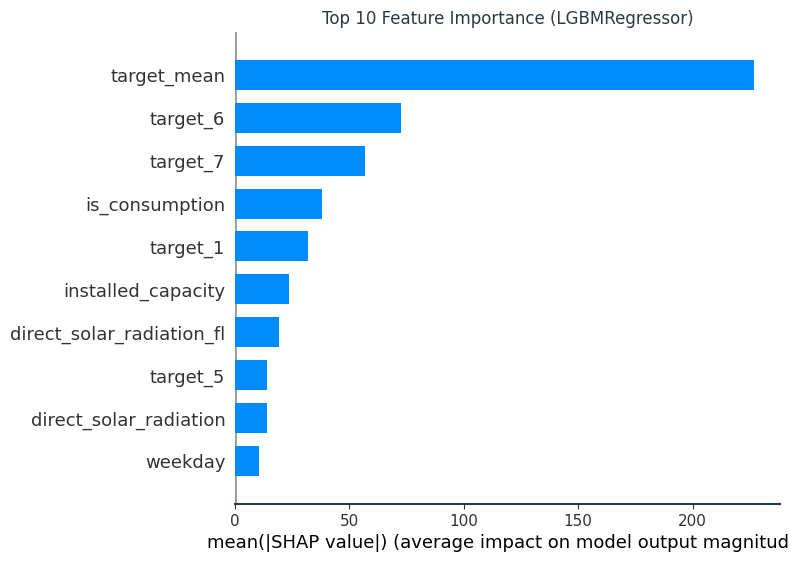

In [64]:
shap_values_lgbm = shap_values_test['LGBMRegressor']
shap_values_lgbm_top10 = np.abs(shap_values_lgbm.values).mean(0).argsort()[::-1][:10]
plt.figure(figsize=(8, 4))
shap.summary_plot(shap_values_lgbm[:, shap_values_lgbm_top10], X_test.iloc[:, shap_values_lgbm_top10], plot_type="bar", show=False)
plt.title("Top 10 Feature Importance (LGBMRegressor)", fontsize=12)
plt.show()

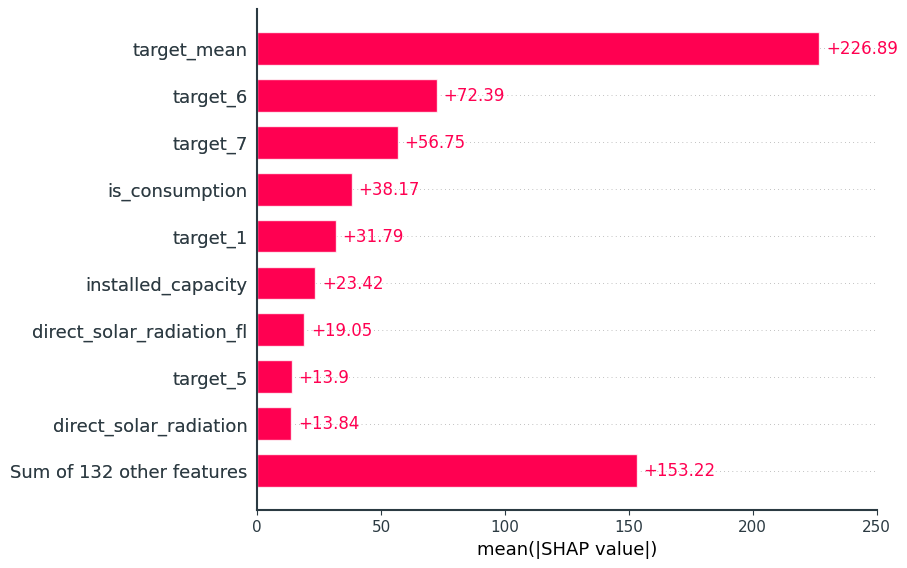

In [67]:
shap.plots.bar(shap_values_lgbm, show=False)
plt.show()
# plt.savefig("plots/bar.png")

In [20]:
lgbm_model_predictions = lgbm_model.predict(X_test)
i_med = np.argsort(lgbm_model_predictions)[len(lgbm_model_predictions)//2]
i_max = np.argmax(lgbm_model_predictions)
i_80 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.8)]
i_60 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.6)]
i_40 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.4)]
i_20 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.2)]
i_min = np.argmin(lgbm_model_predictions)


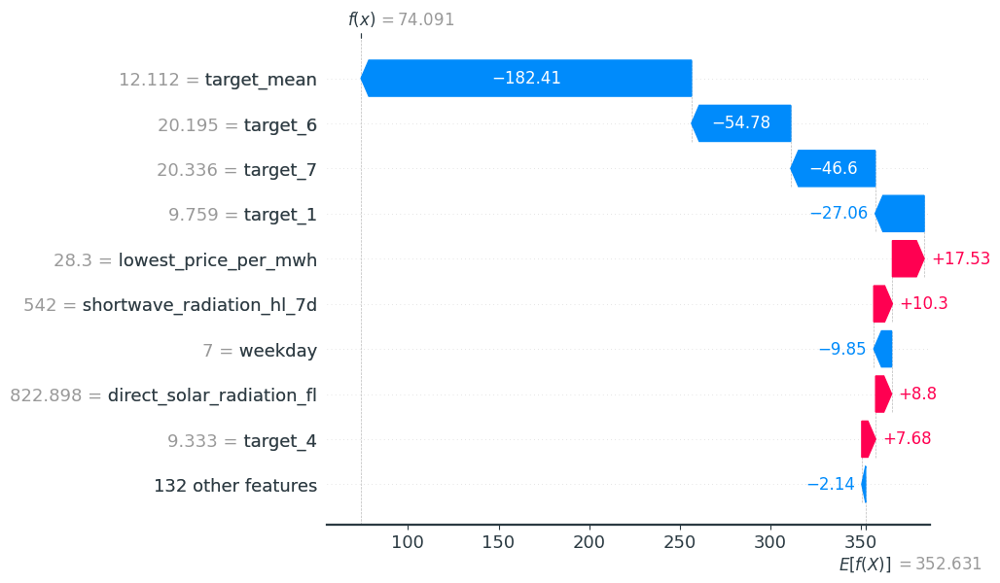

In [21]:
shap.plots.waterfall(shap_values_lgbm[i_med],show=True)
plt.show()
# plt.savefig("plots/waterfall_median.png")

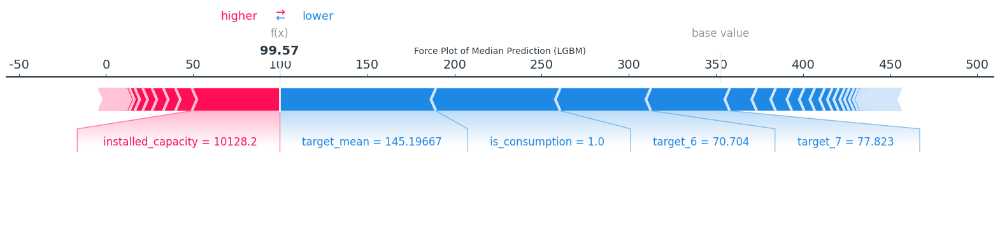

In [74]:
shap.plots.force(shap_values_lgbm[i_med], show=False, matplotlib=True)
plt.title("Force Plot of Median Prediction (LGBM)", fontsize=10)
plt.show()

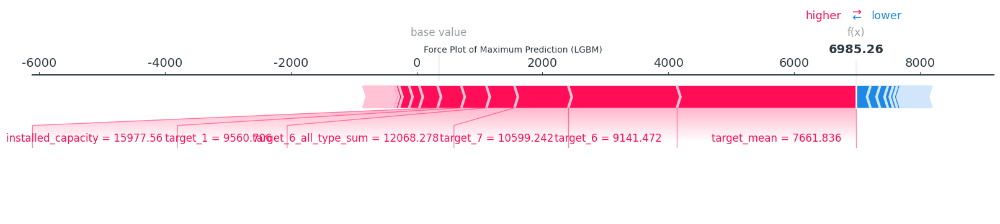

In [73]:
shap.plots.force(shap_values_lgbm[i_max], show=False, matplotlib=True)
plt.title("Force Plot of Maximum Prediction (LGBM)", fontsize=10)
plt.show()
# plt.savefig("plots/force_max.png")

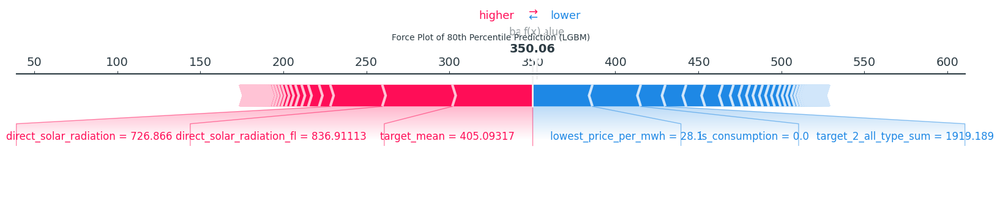

In [79]:
shap.plots.force(shap_values_lgbm[i_80], show=False, matplotlib=True)
plt.title("Force Plot of 80th Percentile Prediction (LGBM)", fontsize=10, pad=20)
plt.show()
plt.show()
# plt.savefig("plots/force_80.png")

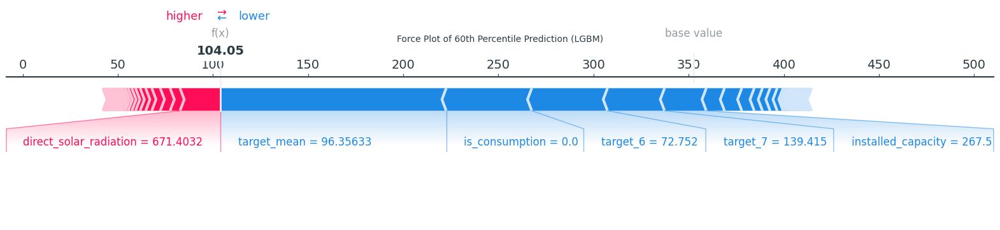

In [80]:
shap.plots.force(shap_values_lgbm[i_60], show=False, matplotlib=True)
plt.title("Force Plot of 60th Percentile Prediction (LGBM)", fontsize=10, pad=20)
plt.show()
# plt.savefig("plots/force_60.png")

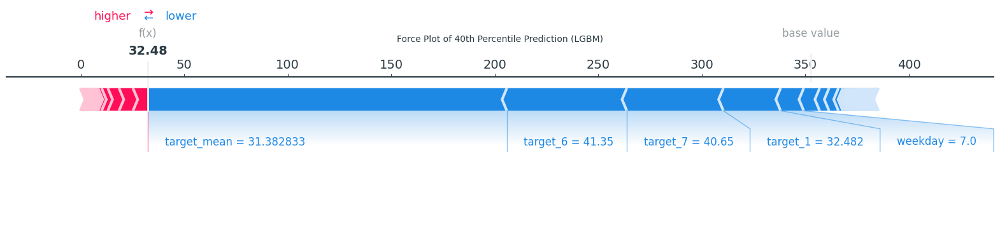

In [81]:
shap.plots.force(shap_values_lgbm[i_40], show=False, matplotlib=True)
plt.title("Force Plot of 40th Percentile Prediction (LGBM)", fontsize=10, pad=20)
plt.show()
# plt.savefig("plots/force_40.png")

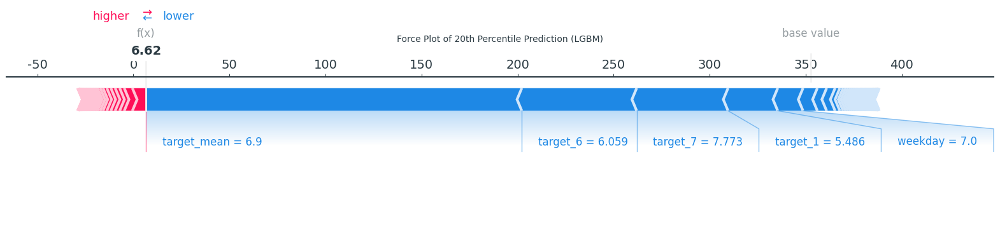

In [82]:
shap.plots.force(shap_values_lgbm[i_20], show=False, matplotlib=True)
plt.title("Force Plot of 20th Percentile Prediction (LGBM)", fontsize=10, pad=20)
plt.show()
# plt.savefig("plots/force_20.png")

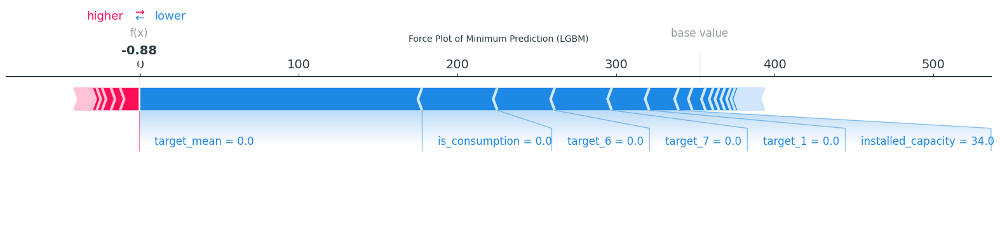

In [83]:
shap.plots.force(shap_values_lgbm[i_min], show=False, matplotlib=True)
plt.title("Force Plot of Minimum Prediction (LGBM)", fontsize=10, pad=20)
plt.show()
# plt.savefig("plots/force_min.png")

## Interprete with Decision Tree

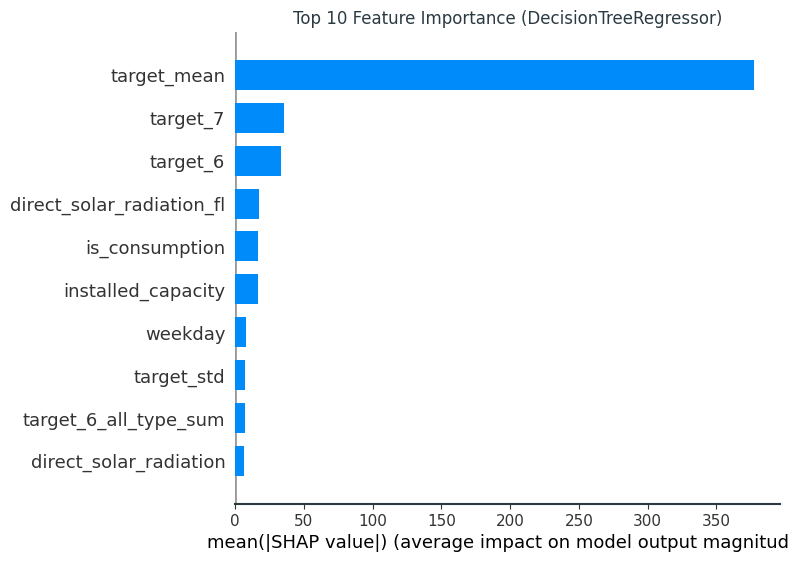

In [65]:
shap_values_dt = shap_values_test['DecisionTreeRegressor']
shap_values_dt_top10 = np.abs(shap_values_dt.values).mean(0).argsort()[::-1][:10]
plt.figure(figsize=(8, 4))
shap.summary_plot(shap_values_dt[:, shap_values_dt_top10], X_test.iloc[:, shap_values_dt_top10], plot_type="bar", show=False)
plt.title("Top 10 Feature Importance (DecisionTreeRegressor)", fontsize=12)
plt.show()

In [29]:
dt_model_predictions = dt_model.predict(X_test)

In [30]:
i_med = np.argsort(dt_model_predictions)[len(dt_model_predictions)//2]
i_max = np.argmax(dt_model_predictions)
i_80 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.8)]
i_60 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.6)]
i_40 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.4)]
i_20 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.2)]
i_min = np.argmin(dt_model_predictions)


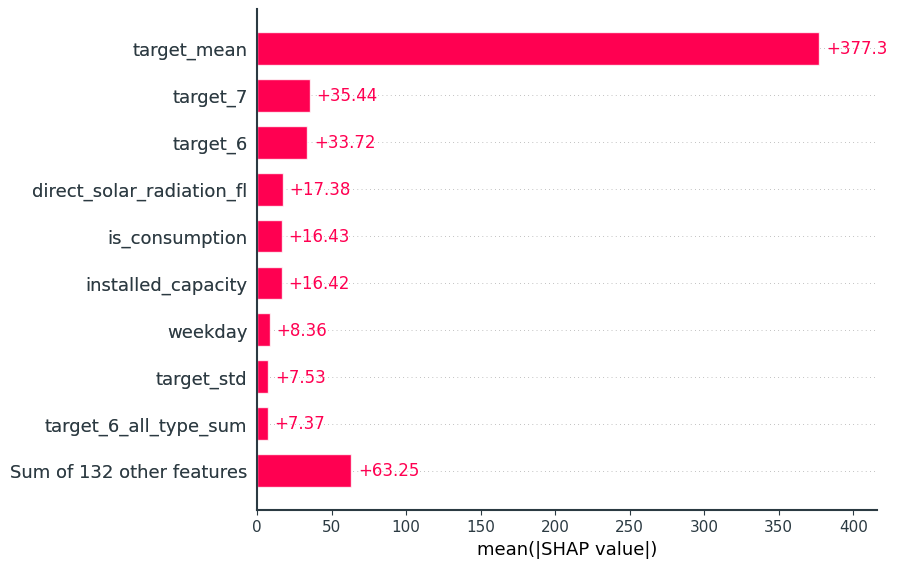

In [31]:
shap.plots.bar(shap_values_dt, show=False)
plt.show()
# plt.savefig("plots/bar.png")

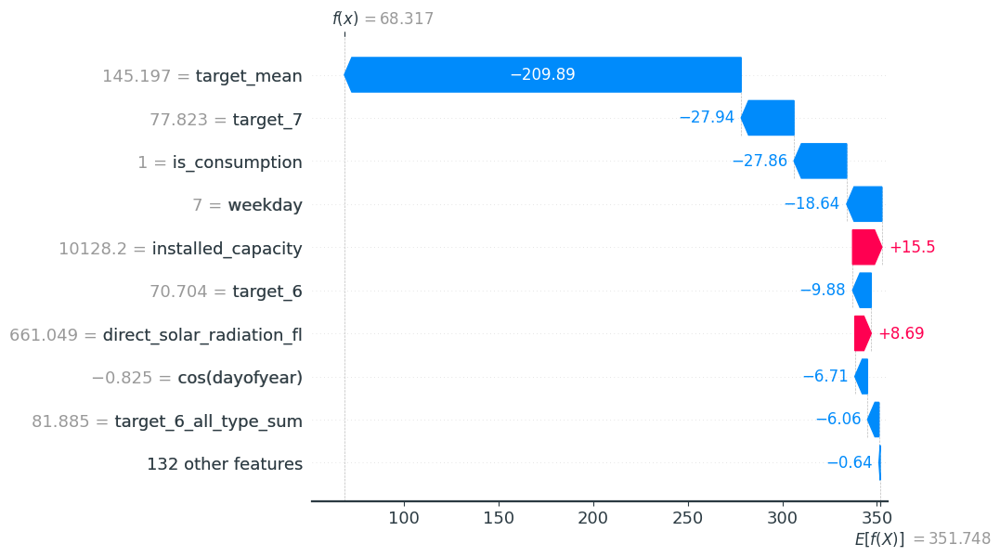

In [32]:
shap.plots.waterfall(shap_values_dt[i_med],show=True)
plt.show()
# plt.savefig("plots/waterfall_median.png")

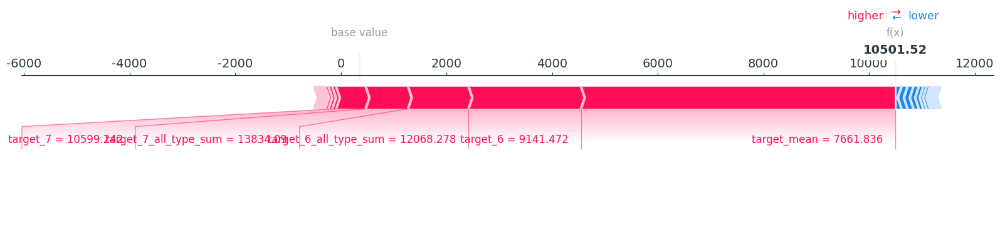

In [33]:
shap.plots.force(shap_values_dt[i_max], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_max.png")

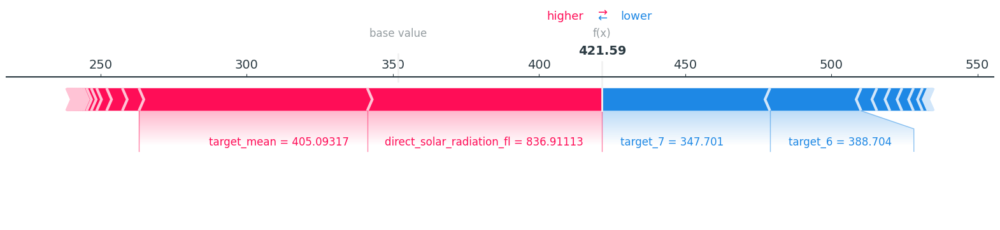

In [34]:
shap.plots.force(shap_values_dt[i_80], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_80.png")

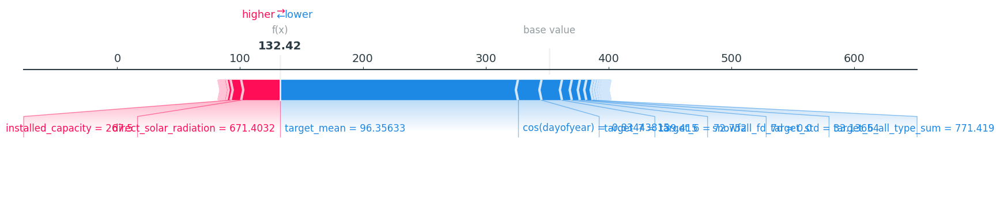

In [35]:
shap.plots.force(shap_values_dt[i_60], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_60.png")

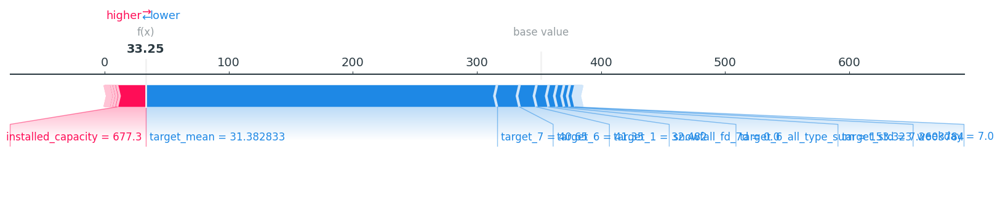

In [36]:
shap.plots.force(shap_values_dt[i_40], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_40.png")

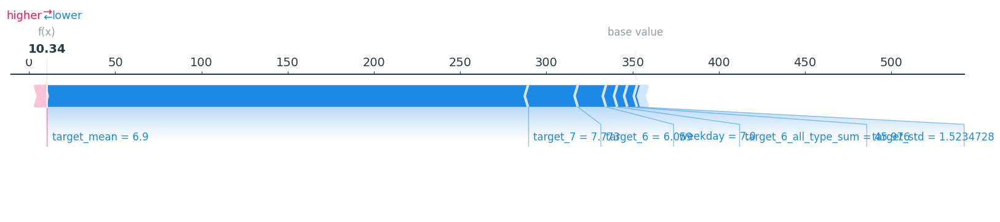

In [37]:
shap.plots.force(shap_values_dt[i_20], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_20.png")

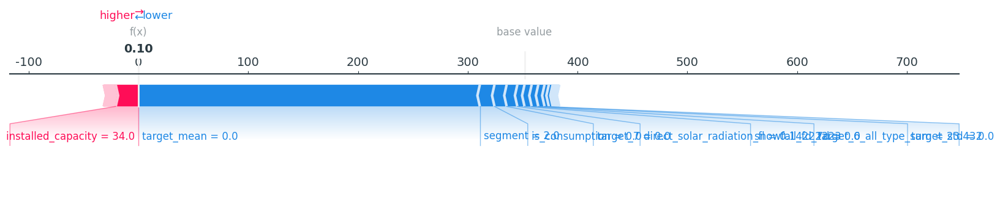

In [38]:
shap.plots.force(shap_values_dt[i_min], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_min.png")

## Interprete with XGBoost

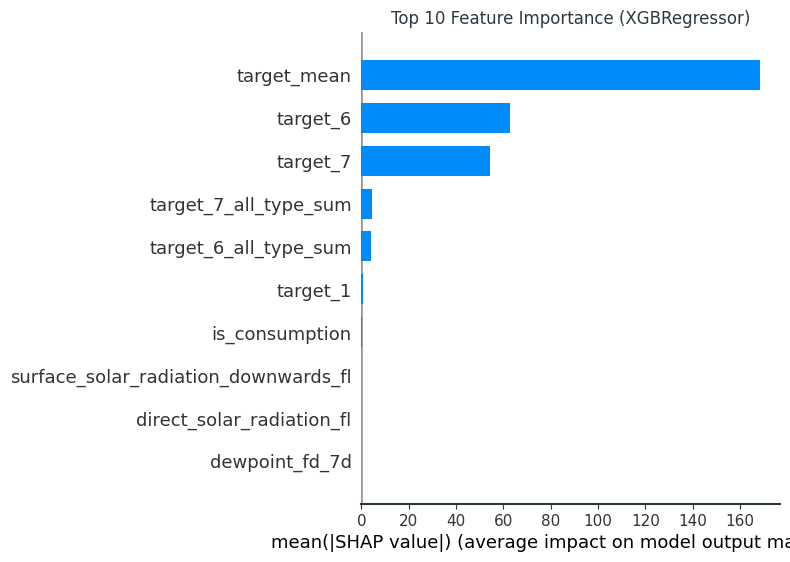

In [66]:
shap_values_xgb = shap_values_test['XGBRegressor']
shap_values_xgb_top10 = np.abs(shap_values_xgb.values).mean(0).argsort()[::-1][:10]
plt.figure(figsize=(8, 4))
shap.summary_plot(shap_values_xgb[:, shap_values_xgb_top10], X_test.iloc[:, shap_values_xgb_top10], plot_type="bar", show=False)
plt.title("Top 10 Feature Importance (XGBRegressor)", fontsize=12)
plt.show()

In [40]:
xgboost_model_predictions = xgboost_model.predict(X_test)

In [41]:
i_med = np.argsort(xgboost_model_predictions)[len(xgboost_model_predictions)//2]
i_max = np.argmax(xgboost_model_predictions)
i_80 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.8)]
i_60 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.6)]
i_40 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.4)]
i_20 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.2)]
i_min = np.argmin(xgboost_model_predictions)


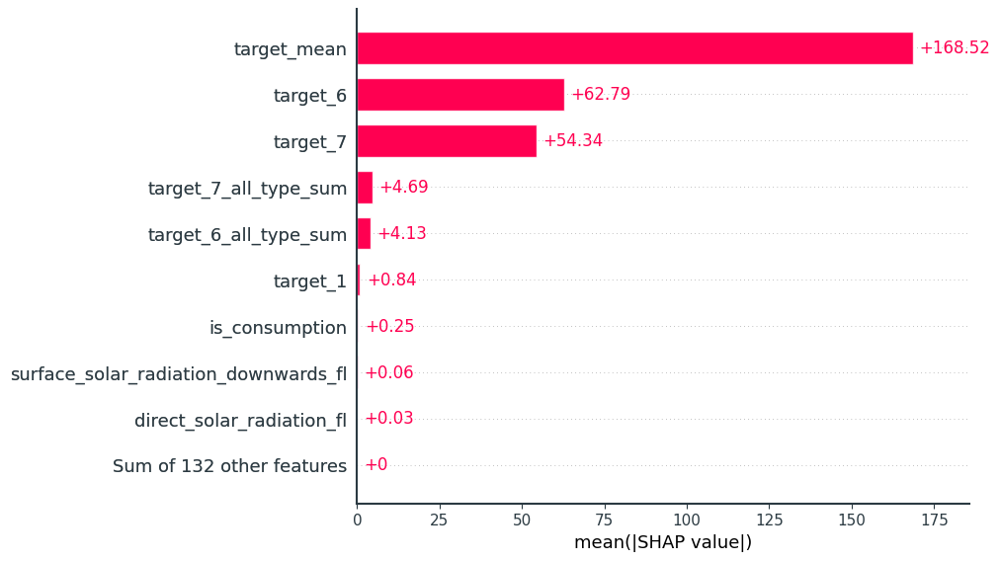

In [42]:
shap.plots.bar(shap_values_xgb, show=False)
plt.show()
# plt.savefig("plots/bar.png")

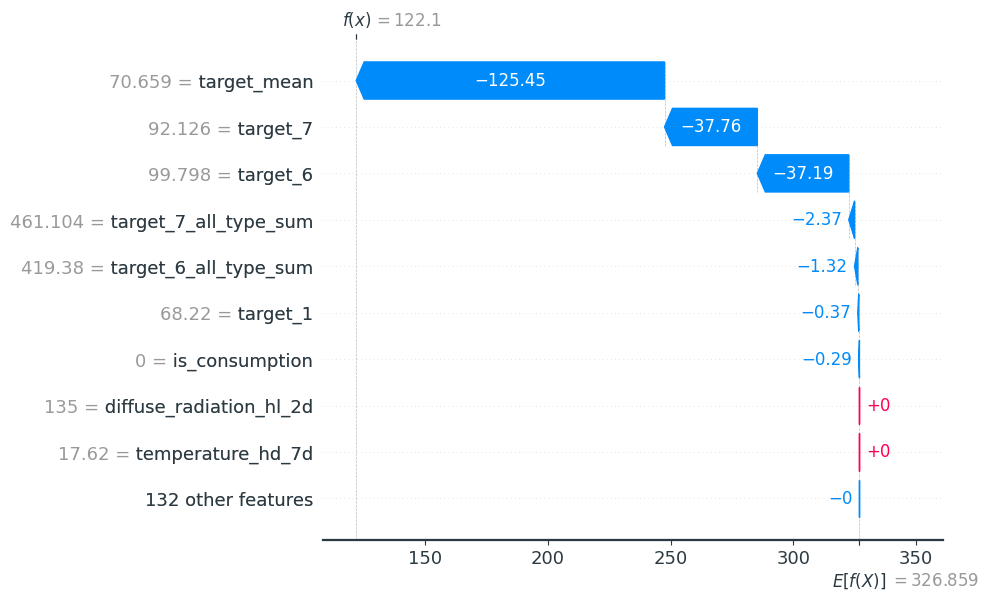

In [43]:
shap.plots.waterfall(shap_values_xgb[i_med],show=True)
plt.show()

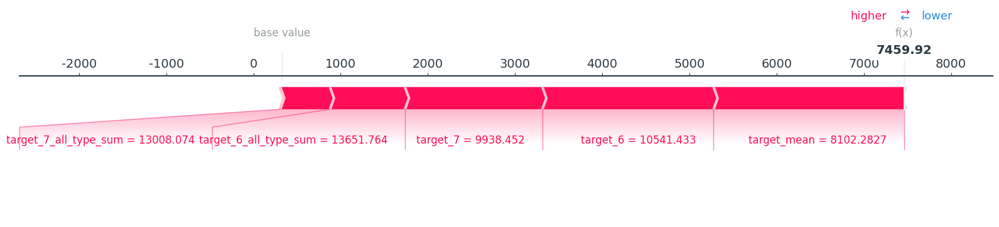

In [44]:
shap.plots.force(shap_values_xgb[i_max], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_max.png")

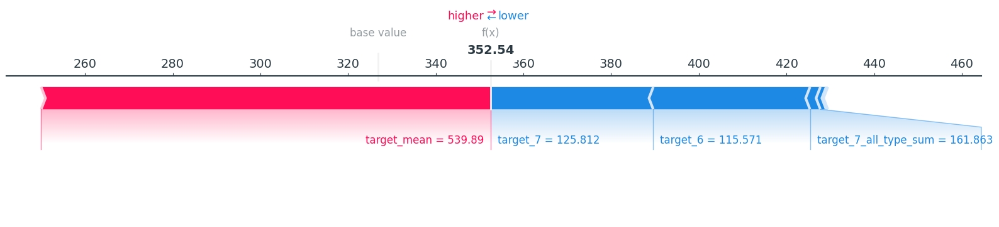

In [45]:
shap.plots.force(shap_values_xgb[i_80], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_80.png")

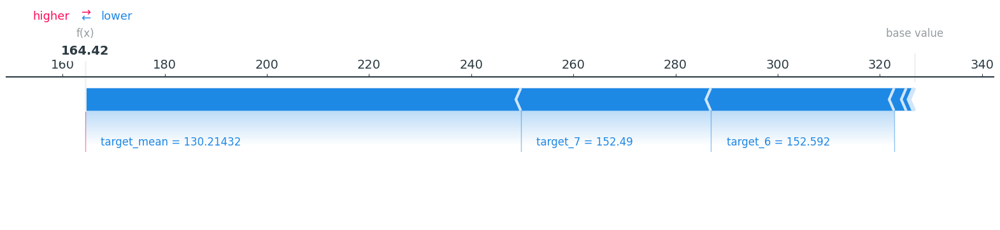

In [46]:
shap.plots.force(shap_values_xgb[i_60], show=False, matplotlib=True)
plt.show()


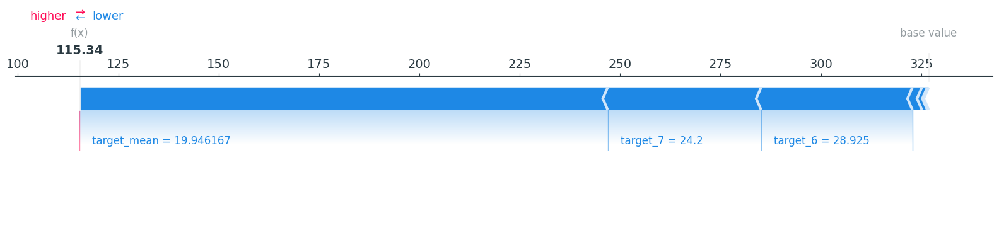

In [47]:
shap.plots.force(shap_values_xgb[i_40], show=False, matplotlib=True)
plt.show()

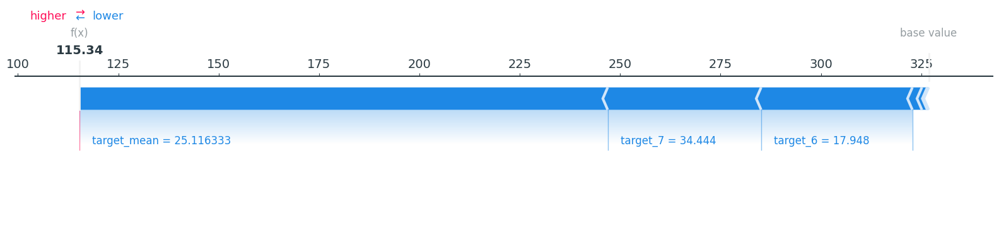

In [48]:
shap.plots.force(shap_values_xgb[i_20], show=False, matplotlib=True)
plt.show()

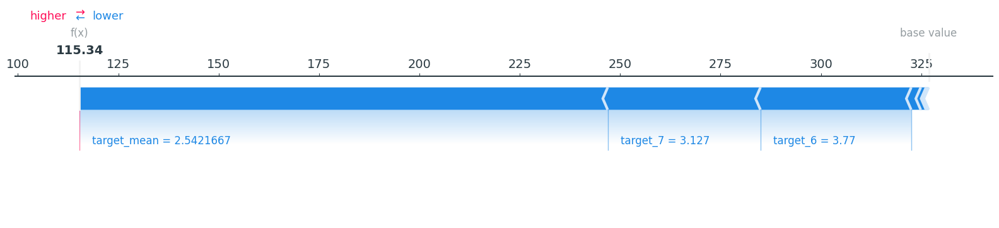

In [49]:
shap.plots.force(shap_values_xgb[i_min], show=False, matplotlib=True)
plt.show()

# Use Lime to explain

## Fitting the Lime value

In [50]:
import torch
import random
from lime.lime_tabular import LimeTabularExplainer
# Set random seeds
random_seed = 7
np.random.seed(random_seed)
random.seed(random_seed)
torch.manual_seed(random_seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False


In [51]:
lime_explainer = LimeTabularExplainer(
    training_data=X_train.values,
    mode='regression',
    feature_names=X_train.columns,
    class_names=['target'],
    verbose=True,
    discretize_continuous=True,
    random_state = random_seed 
)


In [52]:
def display_explainers(dictionary_explainer_dict):
    for key, value in dictionary_explainer_dict.items():
        print(f"Explainer for {key}:")
        value.show_in_notebook(show_table=True)
        print(value.as_list())

## Interprete with LGBM

In [53]:
lgbm_model_predictions = lgbm_model.predict(X_test)
i_med = np.argsort(lgbm_model_predictions)[len(lgbm_model_predictions)//2]
i_max = np.argmax(lgbm_model_predictions)
i_80 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.8)]
i_60 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.6)]
i_40 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.4)]
i_20 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.2)]
i_min = np.argmin(lgbm_model_predictions)


In [54]:
def store_explanations(lime_explainer, X_test, lgbm_model, i_min, i_20, i_40, i_60, i_80, i_med, i_max):
    explanations_dict = {}

    indices = [i_min, i_20, i_40, i_med, i_60, i_80, i_max]
    index_names = ['min', '20', '40', 'med', '60', '80', 'max']

    for i, name in zip(indices, index_names):
        exp = lime_explainer.explain_instance(X_test.values[i], lgbm_model.predict, num_features=10)
        explanations_dict[f"exp_{name}"] = exp

    return explanations_dict

lgbm_explainer_dict = store_explanations(lime_explainer, X_test, lgbm_model, i_min, i_20, i_40, i_60, i_80, i_med, i_max)

Intercept 537.400787623249
Prediction_local [-21.63759761]
Right: -28.051308371787027
Intercept 503.94481267323636
Prediction_local [32.43766192]
Right: 3.2445584876633053
Intercept 475.9635972468823
Prediction_local [21.24034509]
Right: 38.37594016947155
Intercept 436.82073102219107
Prediction_local [99.87974035]
Right: 74.09099664943754
Intercept 366.83963540508154
Prediction_local [161.65744059]
Right: 122.78548642495842
Intercept 87.43907114338907
Prediction_local [846.44281666]
Right: 404.5166460204095
Intercept -38.21404925280211
Prediction_local [5455.04977288]
Right: 9435.635441919529


In [55]:
display_explainers(lgbm_explainer_dict)

Explainer for exp_min:


[('1.24 < target_mean <= 37.05', -321.826781973565), ('is_consumption <= 0.00', -127.6305843776356), ('0.77 < target_6 <= 32.76', -72.93926001399527), ('0.77 < target_1 <= 32.80', -65.63232351153444), ('0.76 < target_7 <= 32.64', -53.60968153898582), ('shortwave_radiation > 209.02', 47.980470014075344), ('cloudcover_low_hd_2d <= 9.23', 40.51805821132813), ('1.00 < direct_solar_radiation_fl <= 313.83', 40.09808801371654), ('0.00 < snowfall_hd_2d <= 0.00', -39.58265929030379), ('year > 2022.00', -6.41371076406785)]
Explainer for exp_20:


[('1.24 < target_mean <= 37.05', -304.5134101641774), ('is_consumption <= 0.00', -116.79732289332392), ('direct_solar_radiation_fl > 313.83', 74.35551308586415), ('0.77 < target_6 <= 32.76', -56.598370924661246), ('13.22 < direct_solar_radiation_fd_7d <= 348.25', 47.01545220504056), ('0.77 < target_1 <= 32.80', -46.71721238006106), ('19.20 < cloudcover_mid_hl_7d <= 63.00', 46.0602289185548), ('-0.00 < cos(hour) <= 0.71', -43.83447341288793), ('104.18 < euros_per_mwh <= 160.00', -41.28445175479743), ('year > 2022.00', -29.19310343256134)]
Explainer for exp_40:


[('1.24 < target_mean <= 37.05', -285.7802259512266), ('0.50 < is_consumption <= 1.00', 118.25263588890924), ('32.76 < target_6 <= 168.34', -66.17080587721787), ('32.80 < target_1 <= 169.34', -58.60302950309202), ('snowfall_hl_7d <= 0.00', -47.09455640994197), ('cloudcover_low_hd_2d <= 9.23', -39.794332792233604), ('cloudcover_high_hl_2d <= 0.00', -39.63017271126694), ('32.64 < target_7 <= 167.03', -38.96517091545036), ('winddirection_10m_hd_7d <= 150.19', 36.06865663751788), ('7.58 < temperature_hl_2d <= 13.60', -33.00625052212723)]
Explainer for exp_med:


[('1.24 < target_mean <= 37.05', -300.1675256047829), ('0.50 < is_consumption <= 1.00', 147.27304276586003), ('0.76 < target_7 <= 32.64', -79.67487018555796), ('direct_solar_radiation_fl > 313.83', 75.38289349875306), ('0.77 < target_1 <= 32.80', -58.64291003335301), ('0.77 < target_6 <= 32.76', -50.26861425788339), ('snowfall_fl <= 0.00', -43.645649083483484), ('temperature_hd_7d > 13.32', -37.045557482870755), ('0.77 < target_3 <= 32.77', 35.63694341667002), ('year > 2022.00', -25.788743703052095)]
Explainer for exp_60:


[('37.05 < target_mean <= 180.78', -219.78005892337595), ('0.50 < is_consumption <= 1.00', 120.96380451055032), ('32.64 < target_7 <= 167.03', -62.59422398060524), ('32.76 < target_6 <= 168.34', -53.513101613770395), ('0.06 < cloudcover_low_fd_7d <= 0.24', 42.81116609228736), ('7.99 < temperature <= 13.45', 41.18281032848564), ('year > 2022.00', -38.87195416394158), ('surface_pressure_hl_2d > 1014.32', 36.928355140253345), ('9.64 < surface_solar_radiation_downwards_fl <= 213.07', -36.25168674014787), ('32.80 < target_1 <= 169.34', -36.05730546591627)]
Explainer for exp_80:


[('target_mean > 180.78', 800.1212967670211), ('year > 2022.00', -441.9261706376002), ('target_6 > 168.34', 192.74519516759202), ('target_7 > 167.03', 178.4156909838423), ('target_1 > 169.34', 125.22911684900737), ('is_consumption <= 0.00', -116.15179958920626), ('direct_solar_radiation_fl > 313.83', 64.56200247748359), ('target_std > 45.16', -45.85616270762137), ('installed_capacity > 1537.70', 31.08813591443648), ('winddirection_10m_hd_7d <= 150.19', -29.223559710332847)]
Explainer for exp_max:


[('year > 2022.00', 3980.5856690396067), ('target_mean > 180.78', 845.8144872747978), ('target_6 > 168.34', 203.62100900766114), ('target_7 > 167.03', 176.98085595072223), ('target_1 > 169.34', 161.66044415500397), ('0.50 < is_consumption <= 1.00', 132.49565882635582), ('target_4 > 168.80', -39.117599706583576), ('rain_hl_7d > 0.00', 32.00560810986395), ('target_std > 45.16', -30.600261744788714), ('installed_capacity > 1537.70', 29.817951220113653)]


## Interprete with Decision Tree

In [56]:
dt_model_predictions = dt_model.predict(X_test)
i_med = np.argsort(dt_model_predictions)[len(dt_model_predictions)//2]
i_max = np.argmax(dt_model_predictions)
i_80 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.8)]
i_60 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.6)]
i_40 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.4)]
i_20 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.2)]
i_min = np.argmin(dt_model_predictions)


In [57]:
dt_explainer_dict = store_explanations(lime_explainer, X_test, dt_model, i_min, i_20, i_40, i_60, i_80, i_med, i_max)

Intercept 436.28745456049626
Prediction_local [53.63678008]
Right: 0.09521932311399434
Intercept 464.52727593021064
Prediction_local [40.44294098]
Right: 10.335549098920207
Intercept 557.2351294311404
Prediction_local [-126.19702495]
Right: 33.245104262101705
Intercept 487.7669158903654
Prediction_local [105.0448922]
Right: 68.31701431492837
Intercept 380.25001483325855
Prediction_local [181.80748916]
Right: 132.4158895705525
Intercept 85.81469589843022
Prediction_local [906.59931302]
Right: 421.587376470588
Intercept -5.936794163185937
Prediction_local [6087.43793343]
Right: 10501.524833333335


In [58]:
display_explainers(dt_explainer_dict)


Explainer for exp_min:


[('target_mean <= 1.24', -480.35586046766826), ('1.00 < product_type <= 2.00', 80.90554131478696), ('euros_per_mwh <= 104.18', 69.2365516015831), ('year > 2022.00', -53.54156075814474), ('0.00 < cloudcover_high_hl_2d <= 12.67', -49.54194442701481), ('snowfall_hl_7d <= 0.00', 47.977434178175), ('hours_ahead > 42.00', 46.59353488614429), ('7.99 < temperature <= 13.45', -44.80533739540974), ('total_precipitation_fl <= 0.00', 44.792754661636884), ('snowfall_fd_7d <= 0.00', -43.911788073326974)]
Explainer for exp_20:


[('1.24 < target_mean <= 37.05', -427.5986600567685), ('direct_solar_radiation_fl > 313.83', 57.45904978442042), ('3.00 < month <= 6.00', 56.4189840107011), ('shortwave_radiation > 209.02', 51.79403846304579), ('diffuse_radiation_hl_2d > 89.50', -46.42425561617259), ('cloudcover_total_hl_7d <= 22.67', -45.37306775727733), ('snowfall_fd_7d <= 0.00', -43.43409710984867), ('direct_solar_radiation_fl_7d > 314.82', 42.402450099012256), ('surface_solar_radiation_downwards_fl_7d > 213.31', -39.22138488141894), ('year > 2022.00', -30.10739188349248)]
Explainer for exp_40:


[('1.24 < target_mean <= 37.05', -467.487007678407), ('snowfall_fd_7d <= 0.00', -113.60037770352956), ('0.24 < temperature_fl <= 7.42', -62.614292730114755), ('snowfall_fl_7d <= 0.00', 61.239719108564536), ('cloudcover_mid_fd_7d <= 0.06', 56.985056666747134), ('weekday > 6.00', -56.29427625536802), ('7.38 < direct_solar_radiation_hd_7d <= 108.15', -53.159395247131805), ('10_metre_v_wind_component_fl > 2.55', -50.123754149281865), ('-1.41 < 10_metre_v_wind_component_fl_7d <= 0.70', 42.15860206311005), ('7.23 < direct_solar_radiation_hd_2d <= 108.06', -40.53642845102116)]
Explainer for exp_med:


[('37.05 < target_mean <= 180.78', -341.1489072983587), ('snowfall_hl_7d <= 0.00', -94.89725001618872), ('0.50 < is_consumption <= 1.00', 85.66375838192464), ('3.00 < month <= 6.00', 54.10014966652222), ('eic_count > 67.00', -51.69292647904269), ('4.50 < dewpoint_fd_7d <= 9.74', -50.45592390496152), ('cloudcover_mid_hl_7d <= 0.00', 49.921316944233865), ('cos(dayofyear) <= -0.74', 46.317807011515946), ('cloudcover_total_hd_7d <= 27.92', -43.802170110129275), ('year > 2022.00', -36.72787788547531)]
Explainer for exp_60:


[('37.05 < target_mean <= 180.78', -359.5342733833428), ('snowfall_fl <= 0.00', 65.27038850817516), ('10_metre_v_wind_component_fl <= -1.38', 64.70011676219625), ('31.00 < hours_ahead_fd_7d <= 36.00', 63.88992999545052), ('0.00 < snowfall_hd_2d <= 0.00', -63.81466829827083), ('snowfall_fd_7d <= 0.00', -54.576107065587664), ('4.26 < dewpoint_hd_7d <= 9.64', 51.85292559291526), ('year > 2022.00', -49.39159958662258), ('diffuse_radiation_hl_7d > 89.60', 41.997786349306594), ('cloudcover_low_hl_7d <= 3.00', 41.162975449696155)]
Explainer for exp_80:


[('target_mean > 180.78', 1358.3700747335415), ('year > 2022.00', -485.0119365470249), ('target_7 > 167.03', 72.63504614321869), ('snowfall_fd_7d <= 0.00', -67.82140938887214), ('direct_solar_radiation_fl > 313.83', 63.07533555576565), ('direct_solar_radiation_fl_7d > 314.82', -40.41876085719298), ('0.24 < cloudcover_mid_fd_7d <= 0.53', -40.17205236755203), ('-2.33 < dewpoint_hl_2d <= 3.88', -36.23222922486525), ('euros_per_mwh <= 104.18', -36.029728948628154), ('-1.10 < 10_metre_u_wind_component_fd_7d <= 1.67', 32.39027802078519)]
Explainer for exp_max:


[('year > 2022.00', 4414.086899905143), ('target_mean > 180.78', 1357.1437882641405), ('target_6 > 168.34', 71.26844976277083), ('target_7 > 167.03', 62.59844448215368), ('rain_hl_2d > 0.00', 52.05561365665495), ('snowfall_hl_7d <= 0.00', -50.07545535083853), ('temperature_fl_7d > 13.57', 49.58064392681687), ('cloudcover_total_hl_7d <= 22.67', 47.08317719696318), ('highest_price_per_mwh <= 104.00', 45.62179664292809), ('direct_solar_radiation_fd_7d > 348.25', 44.01136910465901)]


## Interprete with XGBoost

In [118]:
xgboost_model_predictions = xgboost_model.predict(X_test)
i_med = np.argsort(xgboost_model_predictions)[len(xgboost_model_predictions)//2]
i_max = np.argmax(xgboost_model_predictions)
i_80 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.8)]
i_60 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.6)]
i_40 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.4)]
i_20 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.2)]
i_min = np.argmin(xgboost_model_predictions)


In [120]:
xgboost_explainer_dict = store_explanations(lime_explainer, X_test, xgboost_model, i_min, i_20, i_40, i_60, i_80, i_med, i_max)

Intercept 458.34685570288167
Prediction_local [65.71692981]
Right: 115.341805
Intercept 457.8284402944618
Prediction_local [116.95490049]
Right: 115.341805
Intercept 415.59801933591604
Prediction_local [133.40569991]
Right: 115.341805
Intercept 473.0589501828864
Prediction_local [125.3476274]
Right: 122.100006
Intercept 452.7526651603949
Prediction_local [137.72326733]
Right: 164.41515
Intercept 290.72500355882846
Prediction_local [540.88891609]
Right: 352.54465
Intercept 97.18629648971643
Prediction_local [4330.09915182]
Right: 7459.9175


In [121]:
display_explainers(xgboost_explainer_dict)

Explainer for exp_min:


[('1.24 < target_mean <= 37.05', -219.7642829627974), ('0.77 < target_6 <= 32.76', -76.6492353648204), ('0.76 < target_7 <= 32.64', -67.18528849575686), ('year > 2022.00', 49.624874694734096), ('0.00 < direct_solar_radiation_fl <= 1.00', -44.02455949098748), ('cloudcover_total_hd_7d <= 27.92', -34.399779897016124), ('snowfall_fl <= 0.00', 30.898963815290823), ('cloudcover_low_hd_7d <= 9.25', -30.321633332285447), ('installed_capacity > 1537.70', -26.63842101406475), ('shortwave_radiation_hl_7d <= 0.00', 25.829436154483055)]
Explainer for exp_20:


[('1.24 < target_mean <= 37.05', -222.65881485428213), ('0.77 < target_6 <= 32.76', -74.7439870387092), ('32.64 < target_7 <= 167.03', -40.132883030172636), ('cloudcover_total_fl > 1.00', -27.919181431396584), ('20.00 < cloudcover_mid_hl_2d <= 64.50', 27.6460153099669), ('7.94 < temperature_hd_2d <= 13.32', 27.569220527763225), ('7.23 < direct_solar_radiation_hd_2d <= 108.06', -25.09973156961693), ('surface_pressure > 1015.96', -25.05771507922243), ('-1.58 < 10_metre_v_wind_component <= 0.82', 21.13663334018188), ('year > 2022.00', -1.6130959822893958)]
Explainer for exp_40:


[('1.24 < target_mean <= 37.05', -216.78497997213788), ('0.77 < target_6 <= 32.76', -67.79028846507994), ('0.76 < target_7 <= 32.64', -48.723648708113956), ('10_metre_v_wind_component_fl_7d <= -1.41', 37.19351980044795), ('diffuse_radiation_hl_2d > 89.50', 32.86866024548419), ('0.25 < cloudcover_total_fl_7d <= 0.85', -31.2108995295279), ('0.77 < target_2 <= 32.78', 30.516069285082374), ('windspeed_10m_hd_7d <= 3.26', -27.94687933279103), ('snowfall_hl_2d <= 0.00', 27.750022662653222), ('year > 2022.00', -18.063895408768985)]
Explainer for exp_med:


[('37.05 < target_mean <= 180.78', -194.55178311481197), ('32.64 < target_7 <= 167.03', -46.5911848802135), ('32.76 < target_6 <= 168.34', -40.68928773000229), ('direct_solar_radiation_hd_2d > 108.06', -34.151017965392626), ('direct_solar_radiation > 347.99', -33.416046816146995), ('32.78 < target_2 <= 169.18', 26.28571254344057), ('cloudcover_low_fl_7d <= 0.00', 25.992885943909034), ('snowfall_hl_2d <= 0.00', -24.611475159849086), ('0.25 < cloudcover_total_fl_7d <= 0.85', -22.73150430441528), ('year > 2022.00', -3.247621297943914)]
Explainer for exp_60:


[('37.05 < target_mean <= 180.78', -209.62320517052154), ('32.76 < target_6 <= 168.34', -73.88351861576655), ('32.64 < target_7 <= 167.03', -43.80612262538225), ('115.20 < target_7_all_type_sum <= 730.63', -31.550580798787003), ('weekday > 6.00', -29.959717083127366), ('year > 2022.00', 26.69187854097135), ('0.00 < cloudcover_high_fl <= 0.13', 25.374730049208967), ('cloudcover_low_hl_2d <= 3.00', -24.50974416754435), ('shortwave_radiation_hl_7d <= 0.00', 23.445509763768943), ('direct_solar_radiation_fd_7d <= 0.00', 22.791372279837415)]
Explainer for exp_80:


[('target_mean > 180.78', 655.3767942404776), ('year > 2022.00', -188.34426887568353), ('32.76 < target_6 <= 168.34', -69.79191209873028), ('32.64 < target_7 <= 167.03', -50.675941546058326), ('snowfall_hl_7d <= 0.00', -33.14479546990396), ('target_1 > 169.34', 26.10640806867308), ('direct_solar_radiation > 347.99', -24.82606630347552), ('target_4 > 168.80', -23.751619861288308), ('cloudcover_total_hl_7d <= 22.67', -20.777307629716763), ('highest_price_per_mwh <= 104.00', -20.007377990642684)]
Explainer for exp_max:


[('year > 2022.00', 3129.818328646567), ('target_mean > 180.78', 675.008530424915), ('target_6 > 168.34', 211.04769643012767), ('target_7 > 167.03', 159.58971326507546), ('10_metre_v_wind_component_fl_7d <= -1.41', 22.381950871238132), ('row_id > 1195771.75', 22.17723984147847), ('temperature_fl > 13.57', 21.251288306395665), ('snowfall_hl_2d <= 0.00', 17.80624853351035), ('surface_pressure_hd_7d > 1015.84', -13.354947483562515), ('rain_hl_2d <= 0.00', -12.813193503256544)]
